# SSAC - Exploration 18 - OCR
---

# 18-9. 프로젝트 : 다양한 OCR모델 비교하기

> OCR을 이용해 구현할 수 있는 서비스 : 서점 재고 관리, 도서관 도서 위치 관리, 집에 있는 책장 관리 
+ 책장 칸 단위로 사진을 찍어 무슨 책이 어디 있는지 사진을 찍어 파악할 수 있도록 돕는 OCR이 있다면 도움이 되지 않을까? 
+ 도서관에서 검색을 통해 해당 위치를 가면 책이 없는 경우가 있는데 ocr을 통해 도서 위치 확인을 좀 더 자주 할 수 있으면 도서 위치 관리가 좀 더 잘 될 수 있을 것 같다.
+ 가정에서 무슨 책이 있고 어디에 있는지 파악하는데 도움이 될 수 있다.   
   
> 평가 기준
+ 여러 책이 함께 꽂혀 있을 때 다른 책의 제목을 개별적으로 잘 인식 하는지
+ 책 등에 적힌 제목의 방향이 세로와 가로가 혼용되어 있을 때 이를 잘 인식 하는지
+ 다양한 서체로 적혀 있는 책 제목을 잘 인식 하는지
+ 작은 글씨도 잘 인식 하는지   

---
### Step1. 검증용 데이터셋 준비

In [5]:
import os
img_dir = os.getenv('HOME')+'/aiffel/ocr_python/images'
file_list = os.listdir(img_dir)
file_list

['closeupbookshelf_1.jpg',
 'closeupbookshelf_3.jpg',
 'closeupbookshelf_5.jpg',
 'closeupbookshelf_2.jpg',
 'closeupbookshelf_4.jpg']

In [10]:
file_list.sort()
file_list

['closeupbookshelf_1.jpg',
 'closeupbookshelf_2.jpg',
 'closeupbookshelf_3.jpg',
 'closeupbookshelf_4.jpg',
 'closeupbookshelf_5.jpg']

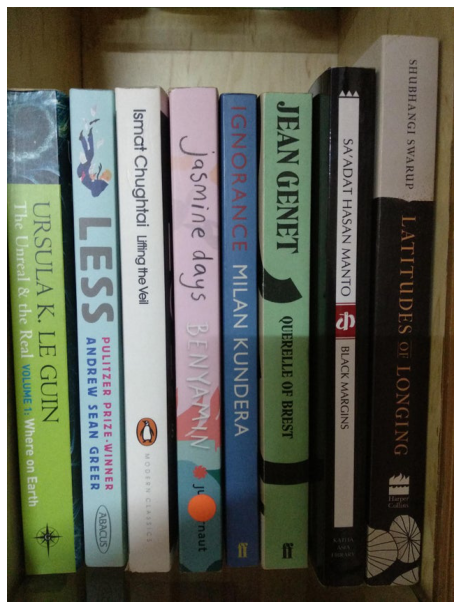

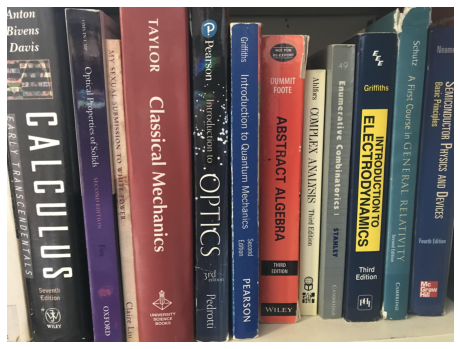

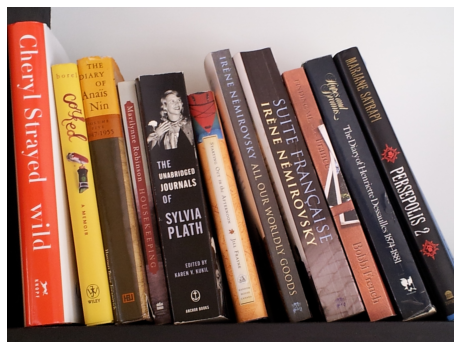

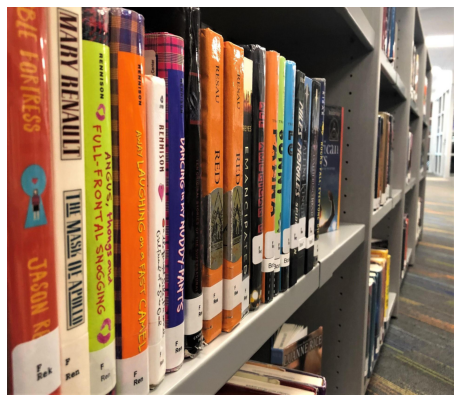

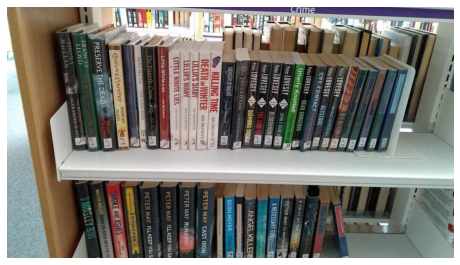

In [16]:
import matplotlib.pyplot as plt
for file in file_list:
    img = plt.imread(os.path.join(img_dir, file))
    plt.figure(figsize = (8,16))
    plt.imshow(img)
    plt.axis('off')
    plt.show()

---
### Step2. Google OCR API, keras-ocr, Tesseract로 테스트 진행
   
> **2-1 Google OCR**

In [18]:
# 다운받은 인증키 경로가 정확하게 지정되어 있어야 합니다. 
!ls -l $GOOGLE_APPLICATION_CREDENTIALS

os.environ["GOOGLE_APPLICATION_CREDENTIALS"] =  os.getenv('HOME')+'/aiffel/ocr_python/my_google_api_key.json'

-rw-rw-r-- 1 ssac7 ssac7 2343  3월 17 11:27 /home/ssac7/aiffel/ocr_python/my_google_api_key.json


In [83]:
def detect_text(path):
    """Detects text in the file."""
    from google.cloud import vision
    import io
    client = vision.ImageAnnotatorClient()

    with io.open(path, 'rb') as image_file:
        content = image_file.read()
        
    image = vision.Image(content=content)

    response = client.text_detection(image=image)
    texts = response.text_annotations
    print('Texts:')

    for text in texts:
        print('"{}"'.format(text.description),end=',  ')

        #vertices = (['({},{})'.format(vertex.x, vertex.y)
                     #for vertex in text.bounding_poly.vertices])

        #print('bounds: {}'.format(','.join(vertices)))

    if response.error.message:
        raise Exception(
            '{}\nFor more info on error messages, check: '
            'https://cloud.google.com/apis/design/errors'.format(response.error.message))

In [165]:
def mark_detection(path):
    from google.cloud import vision
    import io
    client = vision.ImageAnnotatorClient()
    
    with io.open(path, 'rb') as image_file:
        content = image_file.read()
    
    image = vision.Image(content=content)
    
    response = client.text_detection(image=image)
    texts = response.text_annotations
    
    import cv2
    import numpy as np
    img = cv2.imread(path)
    for i in range(1,len(texts)):
        vertices = np.array([[vertex.x, vertex.y] for vertex in texts[i].bounding_poly.vertices])
        text, origin = texts[i].description, (vertices[0][0]-10, vertices[0][1])
        vertices = vertices.reshape((-1,1,2))
        cv2.polylines(img, [vertices], True, (0,0,255), 1, lineType=cv2.LINE_AA)
        cv2.putText(img, text=text, org=origin, fontFace=cv2.FONT_HERSHEY_PLAIN, fontScale=1, color=(255, 0, 0), thickness=1)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.figure(figsize = (20,20))
    plt.imshow(img)
    plt.axis('off')
    plt.show()

In [166]:
path = os.path.join(img_dir, file_list[0])

# 위에서 정의한 OCR API 이용 함수를 호출해 봅시다.
detect_text(path)

Texts:
"Collin
SANIA
AMA
TORARY
SHUBHANGI SWARUP
LATITUDES OF LONGING
SA'ADAT HASAN MANTO S BLACK MARGINS
JEAN GENET
QUERELLE OF BREST
IGNORANCE MILAN KUNDERA
Jasmine days BENYAMIN naut
Ismat Chughtai Lifting the Veil
MODERN CLASSICS
LESS
PULITZER PRIZE-WINNER
ABACUS
ANDREW SEAN GREER
URSULA K. LE GUIN
The Unreal & the Real VOLUME 1: Where on Earth
",  "Collin",  "SANIA",  "AMA",  "TORARY",  "SHUBHANGI",  "SWARUP",  "LATITUDES",  "OF",  "LONGING",  "SA'ADAT",  "HASAN",  "MANTO",  "S",  "BLACK",  "MARGINS",  "JEAN",  "GENET",  "QUERELLE",  "OF",  "BREST",  "IGNORANCE",  "MILAN",  "KUNDERA",  "Jasmine",  "days",  "BENYAMIN",  "naut",  "Ismat",  "Chughtai",  "Lifting",  "the",  "Veil",  "MODERN",  "CLASSICS",  "LESS",  "PULITZER",  "PRIZE-WINNER",  "ABACUS",  "ANDREW",  "SEAN",  "GREER",  "URSULA",  "K.",  "LE",  "GUIN",  "The",  "Unreal",  "&",  "the",  "Real",  "VOLUME",  "1:",  "Where",  "on",  "Earth",  

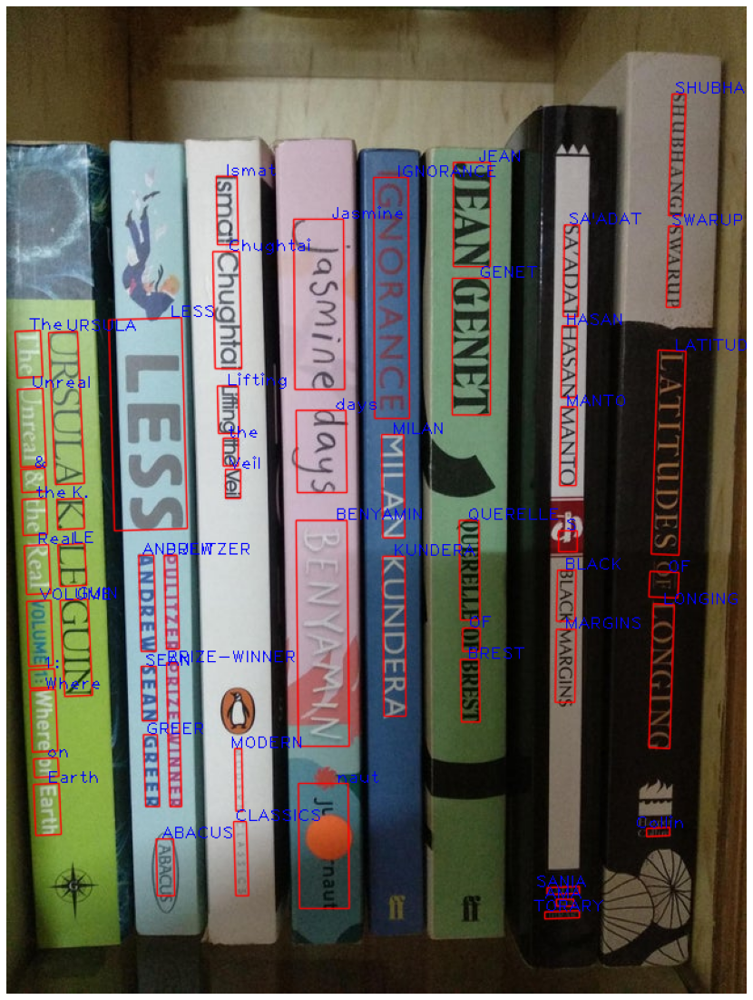

In [167]:
# 인식한 텍스트를 사진에 표시해 봅시다.
mark_detection(path)

Texts:
"Collin
SANIA
AMA
TORARY
SHUBHANGI SWARUP
LATITUDES OF LONGING
SA'ADAT HASAN MANTO S BLACK MARGINS
JEAN GENET
QUERELLE OF BREST
IGNORANCE MILAN KUNDERA
Jasmine days BENYAMIN naut
Ismat Chughtai Lifting the Veil
MODERN CLASSICS
LESS
PULITZER PRIZE-WINNER
ABACUS
ANDREW SEAN GREER
URSULA K. LE GUIN
The Unreal & the Real VOLUME 1: Where on Earth
",  "Collin",  "SANIA",  "AMA",  "TORARY",  "SHUBHANGI",  "SWARUP",  "LATITUDES",  "OF",  "LONGING",  "SA'ADAT",  "HASAN",  "MANTO",  "S",  "BLACK",  "MARGINS",  "JEAN",  "GENET",  "QUERELLE",  "OF",  "BREST",  "IGNORANCE",  "MILAN",  "KUNDERA",  "Jasmine",  "days",  "BENYAMIN",  "naut",  "Ismat",  "Chughtai",  "Lifting",  "the",  "Veil",  "MODERN",  "CLASSICS",  "LESS",  "PULITZER",  "PRIZE-WINNER",  "ABACUS",  "ANDREW",  "SEAN",  "GREER",  "URSULA",  "K.",  "LE",  "GUIN",  "The",  "Unreal",  "&",  "the",  "Real",  "VOLUME",  "1:",  "Where",  "on",  "Earth",  

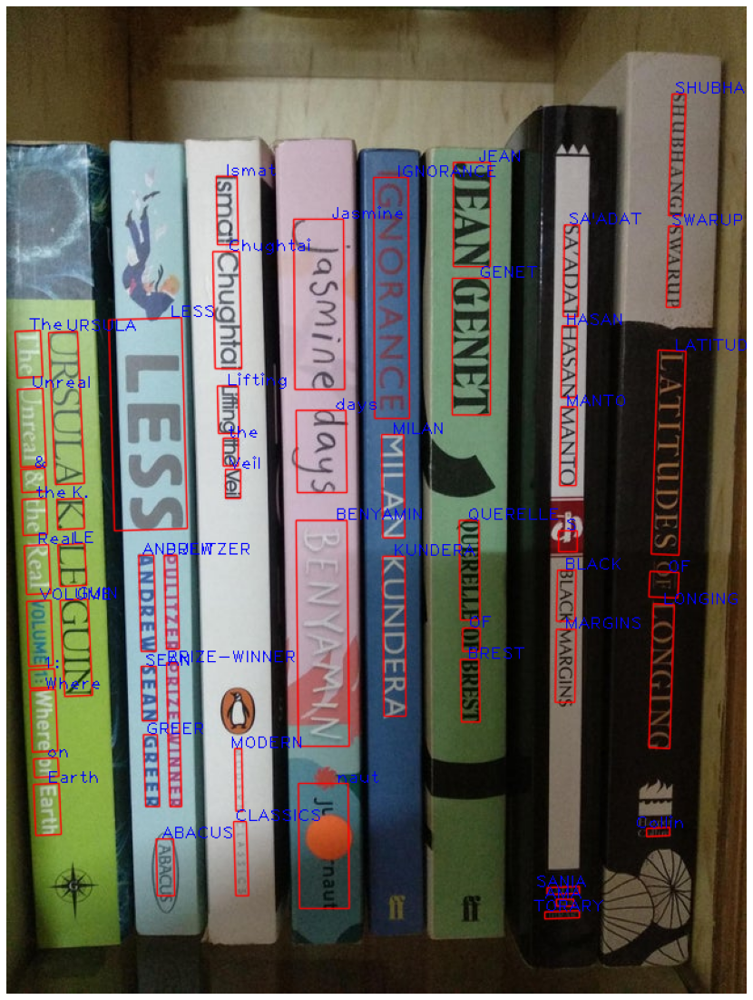

Texts:
"Anton
ifres
Bivens
Davis
Neame
NOT FOR
RE-EXPORT
DUMMIT
FOOTE
Griffiths
Fourth Edition
THIRD
Third
Edition
EDITION
3rd
edition
Mc
Graw
Hill
pH
WILEY
UNIVERSITY
SCIENCE
BOOKS
SEMICONDUCTOR PHYSICS AND DEVICES
Basic Principles
Schutz A First Course in G ENERAL RELATIVITY
CAMBRIDGE
Second Edition
INTRODUCTION TO
ELECTRODYNAMICS
9 Enumerative Combinatorics I STANLEY
CAMBRIDGE
Ahlfors COMPLEX ANALYSIS Third Edition
ABSTRACT ALGEBRA
Second
Griffiths
Introduction to Quantum Mechanics
PEARSON
Edition
e. Pearson . Introduction to
OPTICS E
Pedrotti
TAYLOR
Classical Mechanics
Claire Liu
MY SEXUAL SUBMISSION TO WHITE POWER
OXFORD
Fox
SECOND EDITION
Optical Properties of Solids
OMS IN CMP
BI
u CALCULUS
EARLY T RANSCENDENTALS
",  "Anton",  "ifres",  "Bivens",  "Davis",  "Neame",  "NOT",  "FOR",  "RE-EXPORT",  "DUMMIT",  "FOOTE",  "Griffiths",  "Fourth",  "Edition",  "THIRD",  "Third",  "Edition",  "EDITION",  "3rd",  "edition",  "Mc",  "Graw",  "Hill",  "pH",  "WILEY",  "UNIVERSITY",  "SCIEN

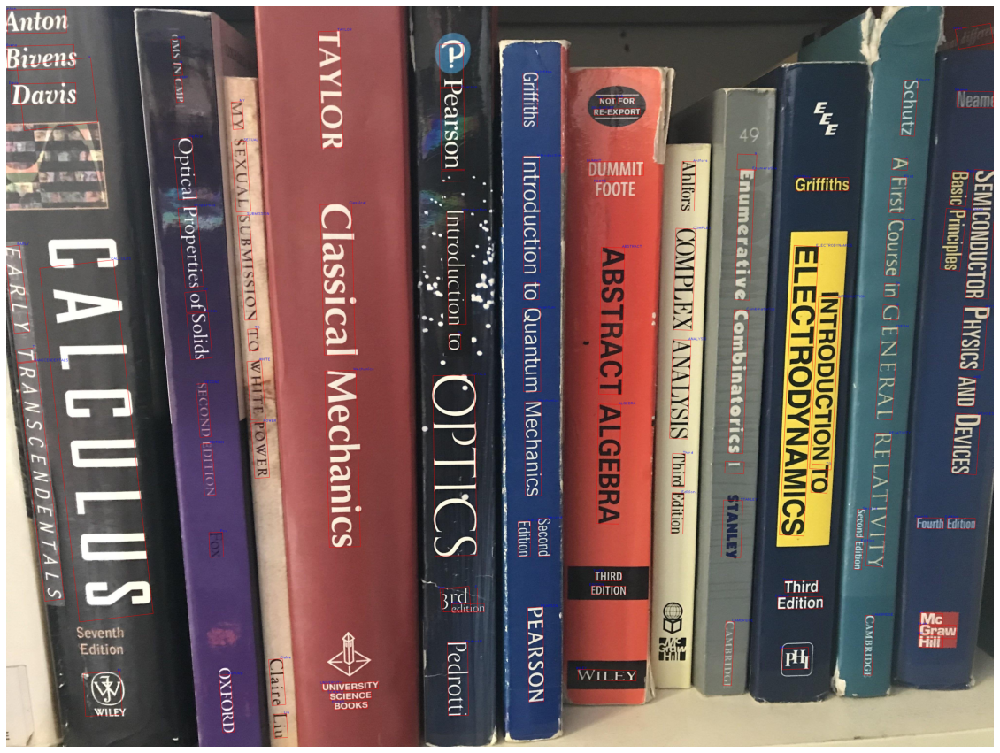

Texts:
"47-1935
WILEY
PERSEPOLIS 2
MARJANE SATRAPI
The Diary of Henrictte Dessaulles 1874-1881
Bobbi French
Hipsand
FINDING ME Irance
SUITE FRANÇAISE
IRÈNE NÉMIRÓVSKY
IRENE NEMIROVSKY ALL OUR WORLDLY GOODS
STARTING OUT in the AFTERNOON JILL FRAYNE
Marilynne Robinson HOUSEKEEPING
国
corked
Cheryl Strayed wild
Harcourt Braie Jovanovich
A MEMOIR
KNOPF
",  "47-1935",  "WILEY",  "PERSEPOLIS",  "2",  "MARJANE",  "SATRAPI",  "The",  "Diary",  "of",  "Henrictte",  "Dessaulles",  "1874-1881",  "Bobbi",  "French",  "Hipsand",  "FINDING",  "ME",  "Irance",  "SUITE",  "FRANÇAISE",  "IRÈNE",  "NÉMIRÓVSKY",  "IRENE",  "NEMIROVSKY",  "ALL",  "OUR",  "WORLDLY",  "GOODS",  "STARTING",  "OUT",  "in",  "the",  "AFTERNOON",  "JILL",  "FRAYNE",  "Marilynne",  "Robinson",  "HOUSEKEEPING",  "国",  "corked",  "Cheryl",  "Strayed",  "wild",  "Harcourt",  "Braie",  "Jovanovich",  "A",  "MEMOIR",  "KNOPF",  

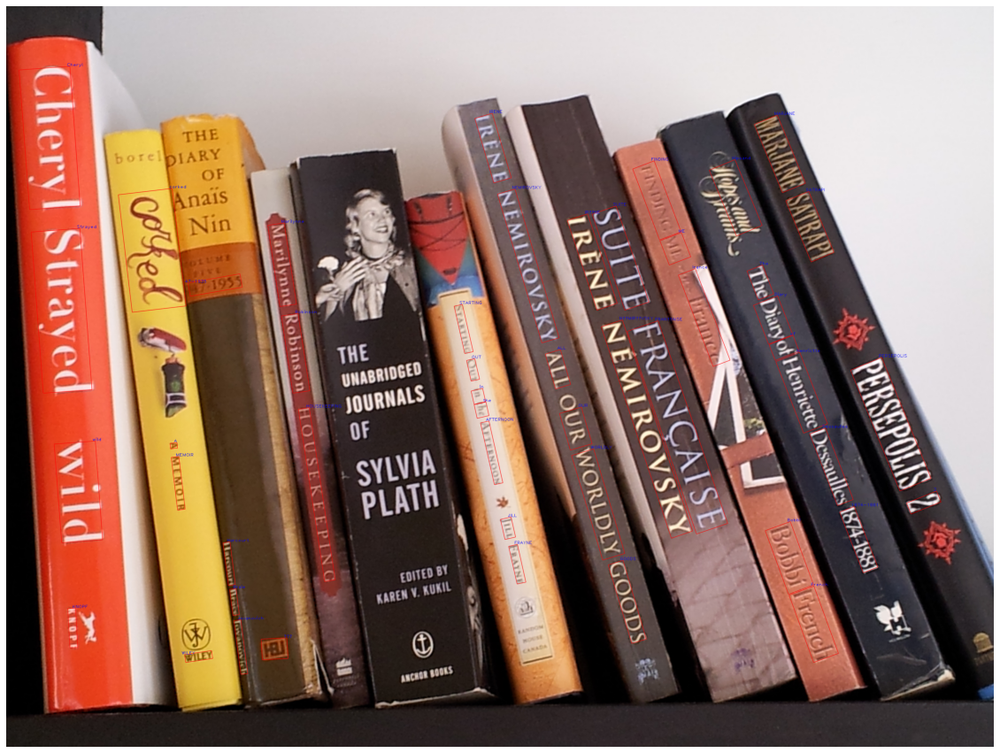

Texts:
"REYES
Bo
Bo30
Rek
Ren
CAN
Ren
Ren
F
Ren
LUANNERICE
RTBAR
iocks FALL, EVERY ONE UTE
GALIILKING IDAR
FALII NG I NGE
MILES MORALES
SPID
E A RA
E M AN CIP ATE D
RED<
RESAAU
RESA U
RED
TEN ORIGINAL STORIES OF THE SUPERNATURAL
VANCING MY NUDDY-PANTS
F
RENNISON
G-2
Center
AWAY LAUGHING ona FAST CAMEL
RENNI SON
ANGUS, thongs and
FULL-FRONTAL SNOGGING
RENNISON
F.
MARY RENAULT
THE MASK (DE APOLLO
JASON R
BIE FORTRESS
",  "REYES",  "Bo",  "Bo30",  "Rek",  "Ren",  "CAN",  "Ren",  "Ren",  "F",  "Ren",  "LUANNERICE",  "RTBAR",  "iocks",  "FALL,",  "EVERY",  "ONE",  "UTE",  "GALIILKING",  "IDAR",  "FALII",  "NG",  "I",  "NGE",  "MILES",  "MORALES",  "SPID",  "E",  "A",  "RA",  "E",  "M",  "AN",  "CIP",  "ATE",  "D",  "RED<",  "RESAAU",  "RESA",  "U",  "RED",  "TEN",  "ORIGINAL",  "STORIES",  "OF",  "THE",  "SUPERNATURAL",  "VANCING",  "MY",  "NUDDY-PANTS",  "F",  "RENNISON",  "G-2",  "Center",  "AWAY",  "LAUGHING",  "ona",  "FAST",  "CAMEL",  "RENNI",  "SON",  "ANGUS,",  "thongs",  "and",  "F

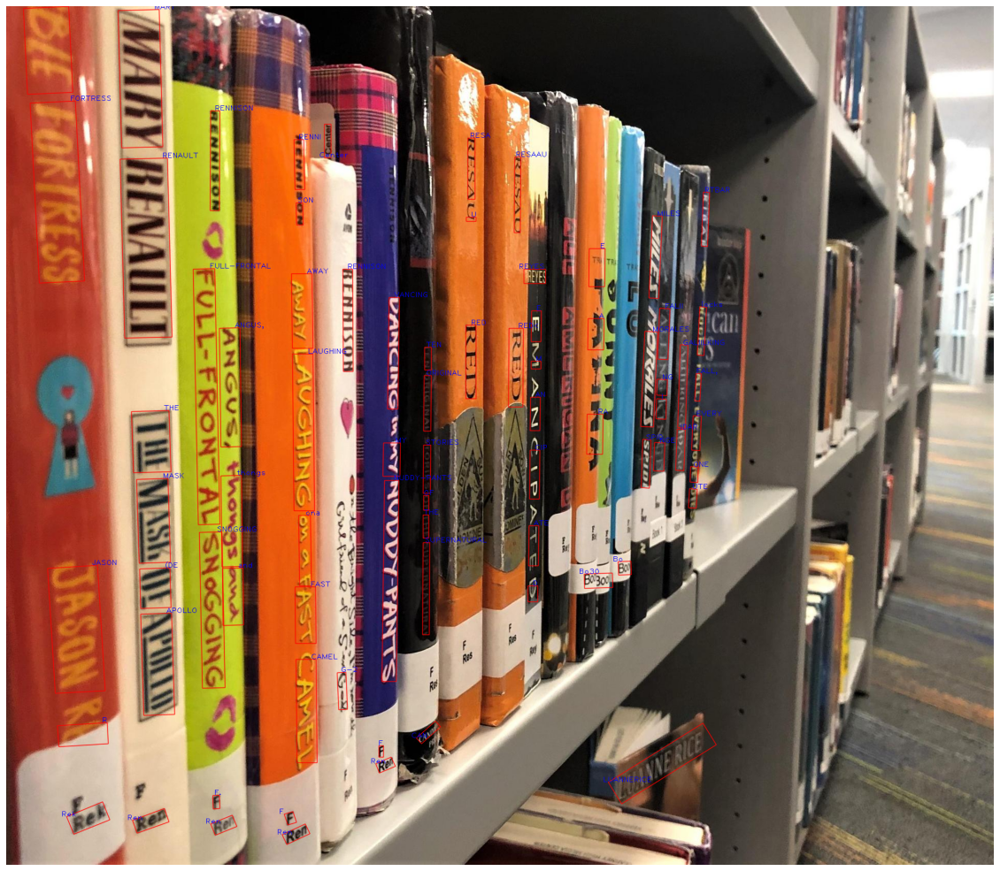

Texts:
"Petti LOVESEY
Peter LOVESEV
EBNSPERTER BO
KEYSTONE
EYE CONTACT So
Peter LOVESEY DEAD GORGEOUS
A TWIST OF THE ENIE
Utterly Knotted Pauline and
Peter LOVESEY UPON A DARK N
Peter LOVESEY BLOODHOUN
PETER MAY rL KEE vOU
A NECESSARY EVIL
Peter LOVESEY THE SUHND
Peter LOVESEY DIAMONO DIA
5ANGELKILLERE
The JAGGED Line cArOLYN MARO
CH
MONIGHT IN MALMO Tiel Marte
DEON MEYER TOAYE rI
ER
O KILLING TIME AN MEFADI e
DEATH IN WINTER AN MCFADYE
LILLIA'S DIARY
LILLIA'S DIARY
PETER MAY CAST IRON
AN MFADYEN
PETER MAY RUNAWAY
AN MOADMEN
LITTLE WHITE LIES NAOYN
PETER MAY ILL KEEP YOU SA
Little White Lies
tA MAEN
The Fourth CrowrPat Mclete
PETER MAY PLL KEEP YOU S.
Helen McCloy THE LONGBODY
A RISING MAN
aryacontonubicto
QUEEN& COUNTRY SHIRLEY
McKAY
A
SMOKE AND ASHES
PRESERVE THE DEAD W BRIAN
WALTER MOSLEY DOWN THE RIVER UNTO THE SE
FRANCES TEHOSE ON GALLOSCRd
LLOYD
MOSLEY
THE REDEMPTION OF
ALEXANDER SEATO
SHONA
MACLEAN
",  "Petti",  "LOVESEY",  "Peter",  "LOVESEV",  "EBNSPERTER",  "BO",  "KEYSTONE",

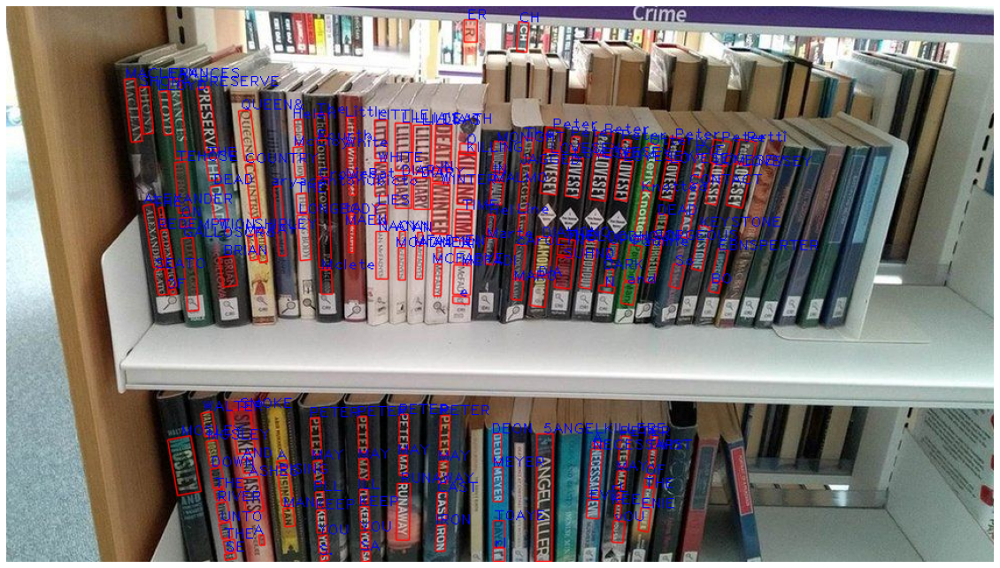

In [168]:
for file in file_list:
    path = os.path.join(img_dir, file)
    detect_text(path)
    mark_detection(path)

+ 3번째 사진에서 가로 방향으로 쓰여진 제목을 잘 인식하지 못했다.
+ 책이 여러개 꽂혀 있는 경우에도 대체적으로 제목을 잘 인식하는 것 같다.
+ cursive, 특이한 글씨체는 잘 인식한다. 
+ 작은 글씨도 잘 인식하는 편이다.
+ 수집한 사진마다 해상도가 상이하여 일괄적으로 시각화 하기에 문제가 있다.
---
> **2-2 keras-ocr**

In [169]:
import matplotlib.pyplot as plt
import keras_ocr

# keras-ocr이 detector과 recognizer를 위한 모델을 자동으로 다운로드받게 됩니다. 
pipeline = keras_ocr.pipeline.Pipeline()

Looking for /home/ssac7/.keras-ocr/craft_mlt_25k.h5
Looking for /home/ssac7/.keras-ocr/crnn_kurapan.h5


In [170]:
images = [keras_ocr.tools.read(os.path.join(img_dir, file)) for file in file_list]
prediction_groups = [pipeline.recognize([os.path.join(img_dir, file)]) for file in file_list]

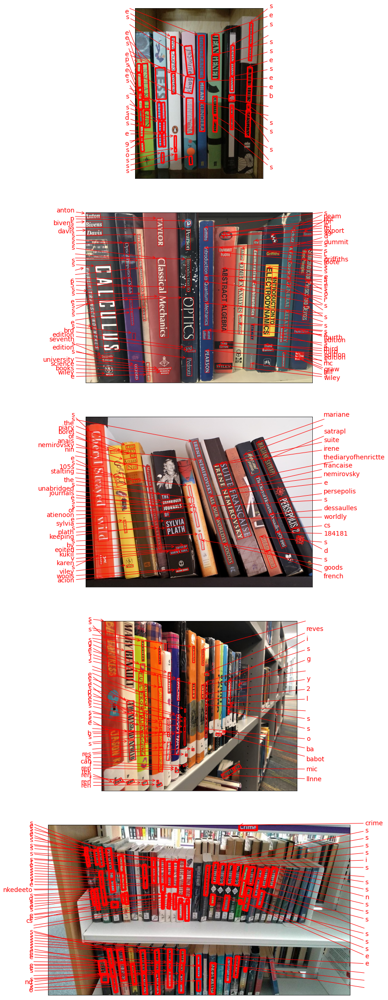

In [172]:
# Plot the predictions
fig, axs = plt.subplots(nrows=len(images), figsize=(40, 40))
for idx, ax in enumerate(axs):
    keras_ocr.tools.drawAnnotations(image=images[idx], 
                                    predictions=prediction_groups[idx][0], ax=ax)

+ 구글 api에 비해 시간이 오래 걸리고 인식률도 좋지 못하다.
  + 거의 대부분의 제목을 제대로 인식하지 못한 것 같다.
---
> **2-3 tesseract**

In [210]:
# 3) 테서랙트로 문자 검출하고 이미지 자르기 (detection)
import os
import pytesseract
from PIL import Image
from pytesseract import Output
import matplotlib.pyplot as plt

# OCR Engine modes(–oem):
# 0 - Legacy engine only.
# 1 - Neural nets LSTM engine only.
# 2 - Legacy + LSTM engines.
# 3 - Default, based on what is available.

# Page segmentation modes(–psm):
# 0 - Orientation and script detection (OSD) only.
# 1 - Automatic page segmentation with OSD.
# 2 - Automatic page segmentation, but no OSD, or OCR.
# 3 - Fully automatic page segmentation, but no OSD. (Default)
# 4 - Assume a single column of text of variable sizes.
# 5 - Assume a single uniform block of vertically aligned text.
# 6 - Assume a single uniform block of text.
# 7 - Treat the image as a single text line.
# 8 - Treat the image as a single word.
# 9 - Treat the image as a single word in a circle.
# 10 - Treat the image as a single character.
# 11 - Sparse text. Find as much text as possible in no particular order.
# 12 - Sparse text with OSD.
# 13 - Raw line. Treat the image as a single text line, bypassing hacks that are Tesseract-specific.

def tesseract_detect(image_path):
    img = cv2.imread(image_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.figure(figsize = (20,20))
    plt.imshow(img)
    plt.axis('off')
    plt.show()
    custom_oem_psm_config = r'--oem 3 --psm 3'
    image = Image.open(image_path)

    recognized_data = pytesseract.image_to_data(
        image, lang='eng',    # 한국어라면 lang='kor'
        config=custom_oem_psm_config,
        output_type=Output.DICT
    )
   
    top_level = max(recognized_data['level'])

    for i in range(len(recognized_data['level'])):
        level = recognized_data['level'][i]
    
        if level == top_level:
            print(recognized_data['text'][i])
    

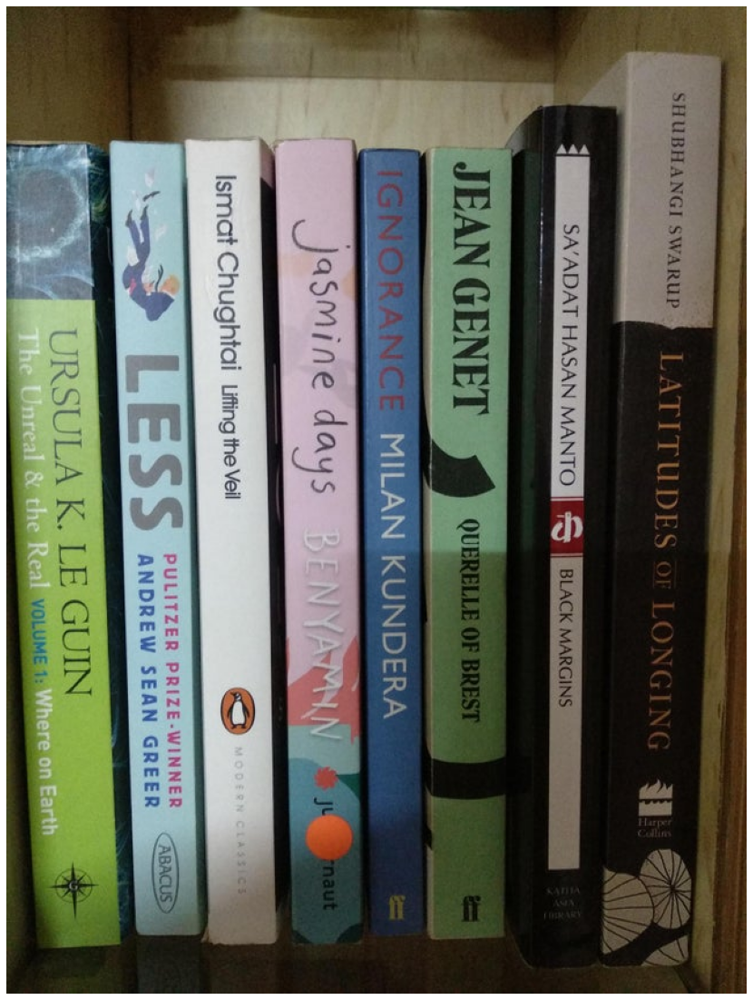

       
 
    
Bh
SA'ADAT
HASAN
MANTO
|
C=]
BLACK
MARGINS
“JEAN
GENET
IGNORANCE
 
ie


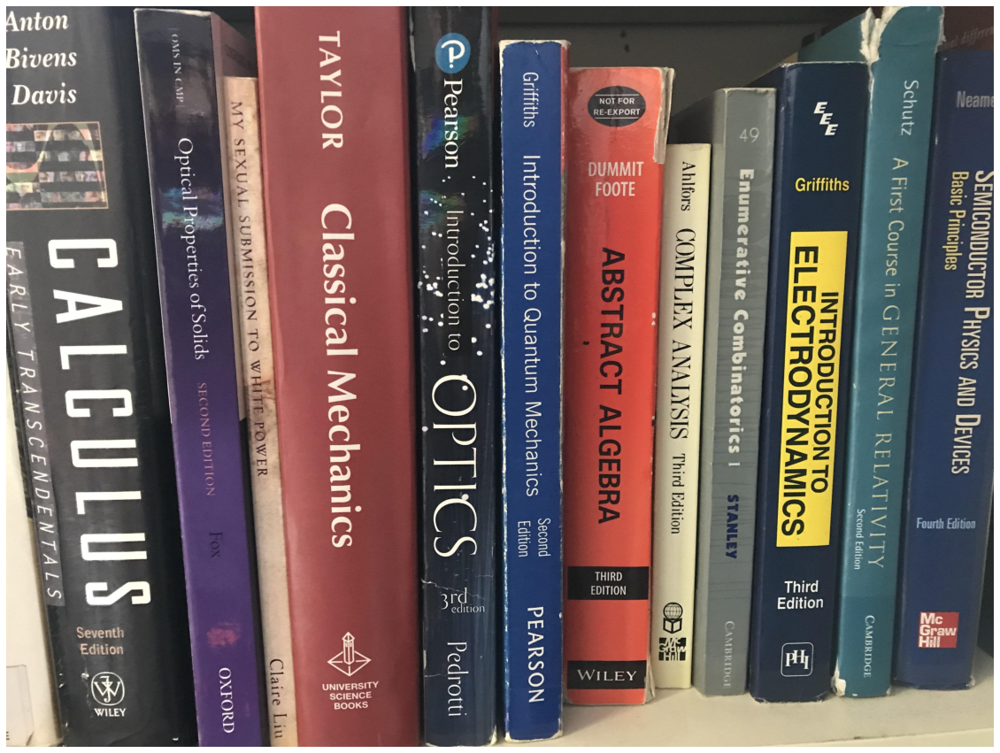

            
 
FE
LOTTA
aT
TRaetT
Devices
lo
Basic
Principles
E
A
Sie
a]
mA
ey
pes
Course
in
G
EN
a
wae
iN:
ow
E
a
AV
CAMBRIDGE
    
 
  
 
 
 
a
SEN
PC
Ree
ens.
Tl
wy
NTROSo
w
=
NTO
Si
We
ELECTRODYNAMICS
(ies
BES
|
oi
Enumerative
Combinatorics
|
Aes
 
i410)
1
       
  
   
amis
Mae
to
Chania
Mechanics
est
PEARSON
 
=
pose,
a
Lr
ee
Pearson
.
ane
to.
a)
PTIC
a
Pedrotti
°
’
5
°
Par
ae
edition
ree
|
WS
tated
SCIENCE
BOOKS
tavLOR
Classical
Mechanics
=)
_
epee
 
Ny
Orel
Le
ab
ae
cen
 
Foperties
of
Solids
oMs
IN
CMP
eye
le
%



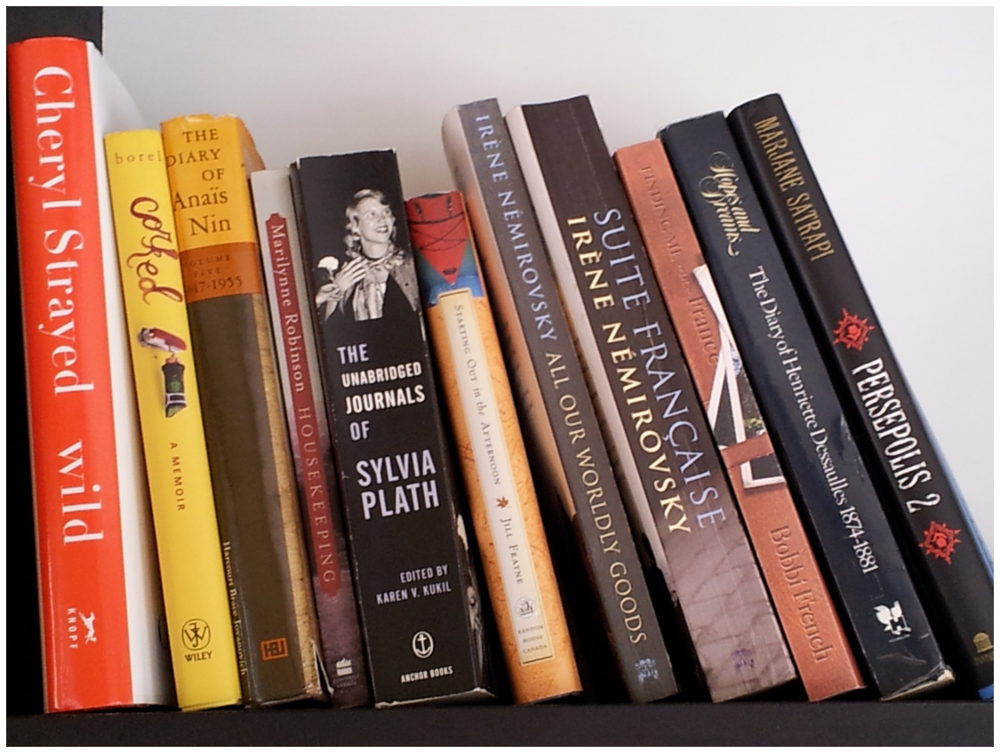

              
aa
ee
‘
:
Robinse®
Sant
rr
eae
NV
a
base
fy
ws
a
¥(
-
“
-
T\
as
.
x
ioe
Circa
Th
5
To
UL
Pe
le
rar
a)
}
ea
a
ont


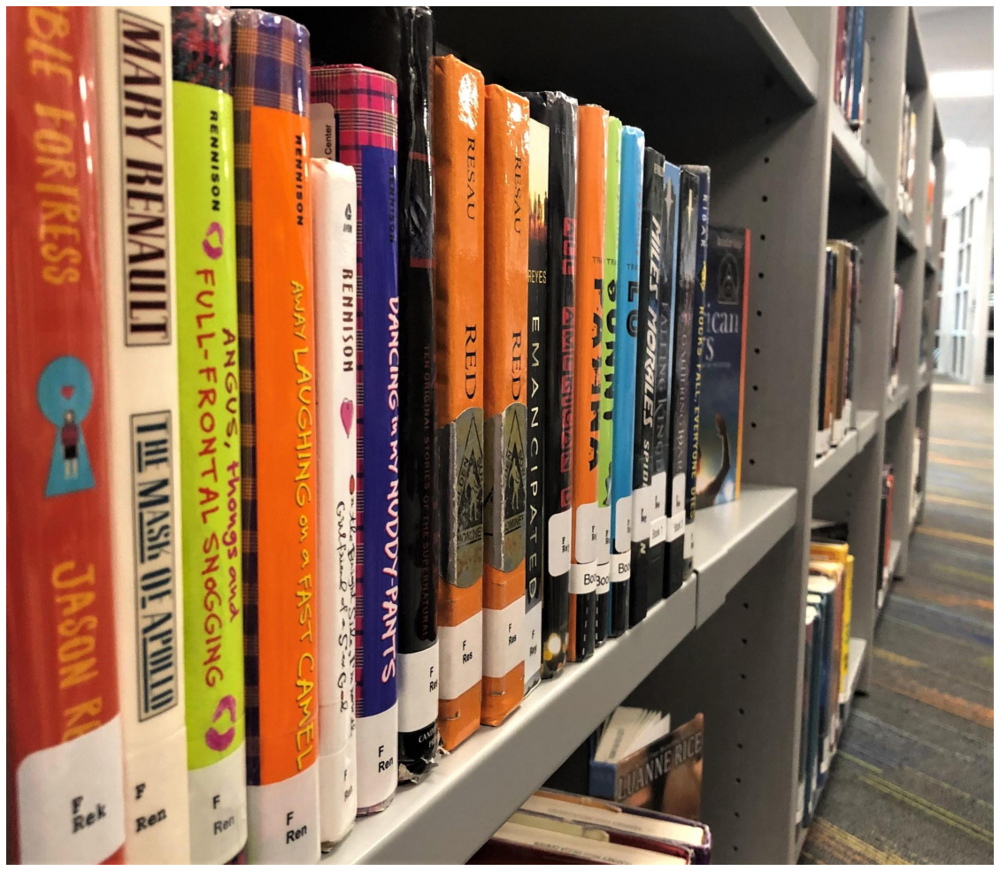

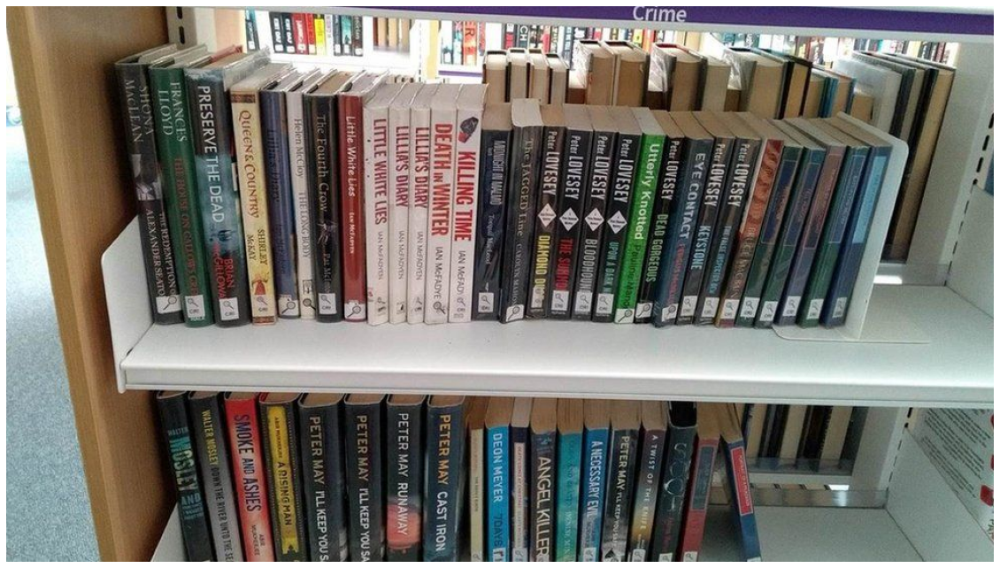

                   
i
———
oe
BNc
Sets
 
Seon
arn
]
ELVA
Nacsa
RA
cr
INE
wo
ASHES
os


In [212]:
for file in file_list:
    tesseract_detect(os.path.join(img_dir, file))

---
### Step3. 결과 분석과 결론 제시
+ 다양한 각도에서 책등만 보이는 사진의 경우 google ocr 외에 다른 api는 제대로 작동하지 않았다. 
+ 구글 ocr이 가장 적합한 방법으로 보인다.